# Topic Modeling Pipeline – From Embeddings to Annotated Clusters

The purpose of this notebook is to perform **topic modeling** and prepare the data for both **automatic annotation** and **meta-clustering**.

We proceed through the following major steps:

1. **Data Loading**  
   Raw textual data is imported and briefly explored.

2. **Vectorization**  
   Using a sentence embedding model, we convert text into numerical vectors suitable for machine learning. These embeddings typically reside in high-dimensional spaces (e.g., 384 or 768 dimensions).

3. **Smart Sampling**  
   Given the size of the dataset, we select a representative sample via a stratified strategy based on coarse clustering. This allows us to build models efficiently while maintaining semantic coverage.

4. **Dimensionality Reduction**  
   To visualize and structure the data, we project the embeddings into a 2D space using **UMAP**.
5. **Clustering**  
   We apply **HDBSCAN**, an unsupervised density-based clustering algorithm, to detect coherent semantic groups within the reduced space.

6. **Inference and Concatenation**  
   The trained UMAP and HDBSCAN models are applied to the rest of the data. We then concatenate the sample and non-sample datasets into one unified corpus with consistent embeddings, projections, and cluster assignments.


> _This notebook is fully documented._ Each step is carefully explained to ensure transparency and reproducibility — **inchaAllah**.

If you have questions or suggestions, feel free to reach out at **F130299945@gmail.com**.  
Please include the name of this repository in the subject line for context.

_Thank you for reading — let’s dive in._


# Step 1: Data importation

In [9]:
import sys
from pathlib import Path

# Ajouter automatiquement le dossier racine du projet au sys.path
root_dir = Path().resolve().parent  # remonte à la racine
if str(root_dir) not in sys.path:
    sys.path.insert(0, str(root_dir))
    
from sentence_transformers import SentenceTransformer
from utils.helper_functions import clean_text
from sklearn.cluster import MiniBatchKMeans
from plotly.subplots import make_subplots
from matplotlib.colors import rgb2hex
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly.express as px
import pandas as pd
import numpy as np
import subprocess
import warnings
import hdbscan
import openai
import umap
import os


from dotenv import load_dotenv
load_dotenv()         # lit .env local
api_key = os.getenv("api_key")
warnings.filterwarnings("ignore")

In [10]:
path = root_dir/Path("data/df_AI_Trends_Linkdin_juin_2025.parquet")
df = pd.read_parquet(path)
__ = df.copy()

In [11]:
n_lines, n_columns = df.shape 
columns = df.columns.tolist()
print(f"Our data contains: {n_lines} documents, and {n_columns} columns\n")
display(f"The columns are: {columns}\n")
display(df.sample(5))
df = df[["text"]].copy()
df["text"] = df.text.apply(lambda x: clean_text(x))


Our data contains: 156479 documents, and 6 columns



"The columns are: ['chunk_id', 'text', 'lemmatized_text', 'document_id', 'start_position', 'end_position']\n"

,chunk_id,text,lemmatized_text,document_id,start_position,end_position
110407,6708851,If you’re curious about how language models ar...,’re curious language model fine tune day espec...,20951430,923,1283
70578,6505816,🎨 AI Generated Contents(AIGC) for the Edge Mob...,🎨 ai generated contents(aigc edge mobile devic...,19271821,805,1311
99456,7140780,Looking for two passionate Engineering Interns...,look passionate engineering interns join team ...,21591862,0,497
83495,7089215,Hybrid Human-AI Collaboration: The future of w...,hybrid human ai collaboration future work repl...,21523778,1260,1830
135187,6740671,🚀 We're Hiring | Python GENAI Engineer 📍 Locat...,hire | python genai engineer location whitefie...,20966236,0,857


## Context

This dataset was collected from the LinkedIn platform as part of a project to **analyze global trends in Artificial Intelligence (AI) in June 2025**. The objective is to better understand what specific themes or topics AI-related posts are focusing on.

We collected thousands of public posts mentioning AI, in **multiple languages** and from **different regions around the world**. Since LinkedIn is a professional network, many posts reflect industry perspectives, research advancements, and product updates.

To respect user privacy, the raw dataset (which included personal account data like name, description, number of followers, etc.) was **anonymized**. All personal identifiers were removed, and **each post was translated into English**, except for a few rare exceptions (e.g., embedded posts or quotes that weren’t easily detected during preprocessing). Fortunately, most LinkedIn content about AI is originally written in English, so translation inconsistencies are minimal.

### Chunking Strategy

Although we collected **72,665 posts**, the final dataset contains **156,479 text chunks**. This is because we split long posts into smaller segments — or _chunks_ — using a sentence splitter. On average, each post yields around **2.15 chunks**.

> Why do this?  
> Many embedding models (like MPNet or BERT) are optimized for **short, coherent text segments**. Long paragraphs may dilute semantic meaning or exceed model input limits. By chunking, we increase granularity and improve both embedding quality and downstream clustering performance.

### Final Dataset

After preprocessing, we obtain a structured dataset with 6 columns:

- `'chunk_id'`, `'document_id'` – unique identifiers for each chunk and its parent post,
- `'start_position'`, `'end_position'` – character offsets indicating where the chunk appears in the full post,
- `'lemmatized_text'` – a lemmatized version of the chunk (used in some optional keyword-based visualizations),
- `'text'` – the raw, English-translated chunk used in this notebook.

> 🔍 For the rest of the pipeline, we will focus **only on the `'text'` column**, which is used to compute embeddings, cluster assignments, and topic annotations.



In summary, we are working with a **real-world, multilingual, noisy dataset** collected from LinkedIn. This makes it an ideal testbed to showcase the robustness of our **clustering and automated annotation pipeline**.


## Descriptive Overview of the Corpus and Scope of Analysis

The studied corpus is a real, multilingual, and noisy dataset sourced from LinkedIn, serving as a relevant testbed to assess the robustness of an automatic clustering and labeling pipeline.

This subsection provides a brief descriptive overview to highlight characteristic properties of social-media data, notably their heterogeneity and the associated textual noise.

For reasons of data governance (anonymization, minimization) and because the objective here is content analysis, account-level variables (e.g., follower counts, followings, biography) are not used. Accordingly, profile-centered correlational analyses (e.g., post length vs. audience size, follow ratio of accounts interested in AI, etc.) fall outside the current scope.

In this overview, the analysis is therefore limited to text: the working table consists of a single text column and 156,479 rows. This is a sizable textual dataset; only a few elementary content analyses are employed at this stage to illustrate the corpus’s general properties.

**Duplicates after normalization:**
Duplicate detection on cleaned text reveals more than 8,750 duplicates (about ~5% of the corpus). The raw data exhibit no duplicates; they emerge after normalization (removal of emojis, superfluous whitespace), which causes some originally distinct posts to become identical. These duplicates are not removed at this stage; a later section will evaluate their impact (bias, complexity, performance) before making a decision

The distribution of lengths (in number of characters) exhibits a pattern typical of social-media data: unimodal, right-skewed, and long-tailed (see Figure `text_length_dist`).


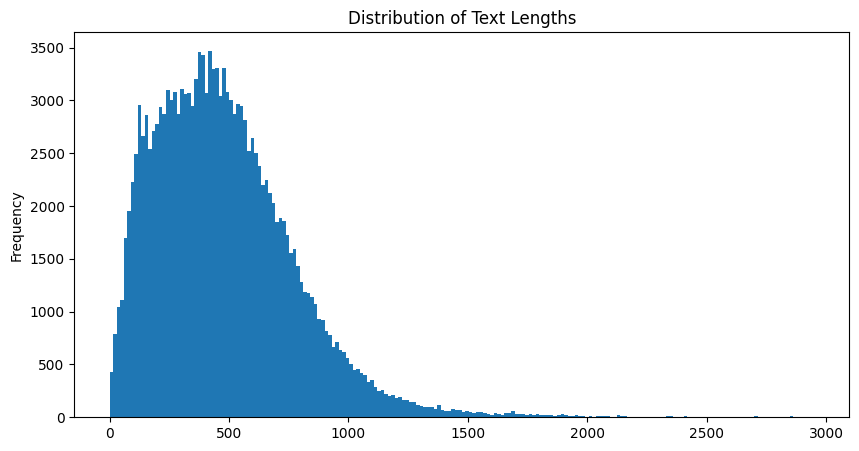

,length
count,156479.000000
mean,482.370037
std,302.040629
min,0.000000
25%,260.000000
50%,442.000000
75%,646.000000
max,2950.000000


In [13]:
_ = df.copy()
_["length"] = df.text.str.len()
_.length.plot.hist(bins=200, figsize=(10, 5), title="Distribution of Text Lengths")
plt.show()
_.describe()

**Across 156,479 segments**, the mean length is **482.37** characters (sd = 302.04) and the median is **442**, confirming the observed **right-skewness** in the histogram (mean > median). The first and third quartiles are **260** and **646**, yielding:

$$
\mathrm{IQR} = 646 - 260 = \mathbf{386}.
$$

In other words, the **central half** of texts lies between 260 and 646 characters, and ~75% of texts are shorter than 646 characters. The **coefficient of variation** is high (CV ≈ 0.63), indicating substantial dispersion around the mean.

The observed minimum is **0** characters; at the other extreme, the maximum reaches **2,950** characters, evidencing a **long tail** with a few very lengthy posts.

A notable edge case is the presence of zero-length texts. This arises from initial preprocessing (removal of emojis and superfluous whitespace), which can transform entries composed **only** of emojis into empty strings. Example of original entries affected:

- **Unicode sequence:** `📊 📅 💬 💻 🤖 💼 💪 😎 🤖 🔧 🔌 💡 ⭐ ⭐ ⭐ ⭐ ⭐ …`  

More generally, very short texts are often **noisy** (isolated reactions, interjections, out-of-context hashtags). For illustration:

`😂 🤣 😂 😂 😂 #how #nope #notinthislifetime` (35 characters)  

Isolated from the surrounding thread, such content provides little actionable signal for thematic analysis.


## Word Count: Distribution and Correlation

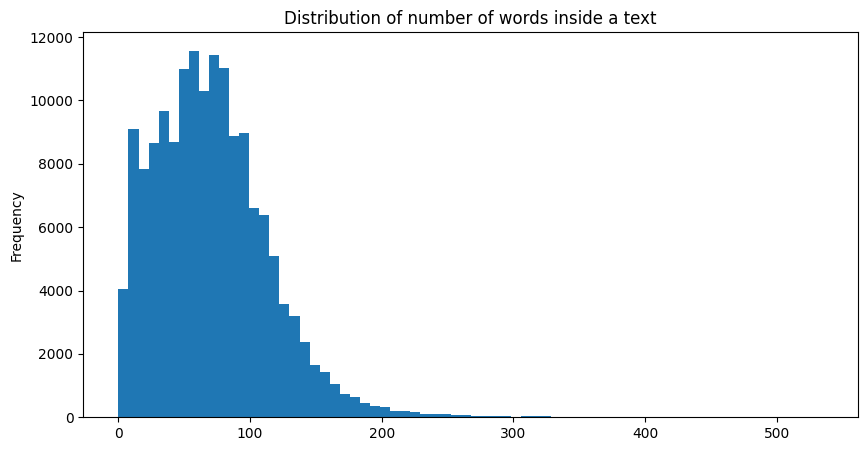

,length,car_lenght
count,156479.000000,156479.000000
mean,70.968405,482.370037
std,43.993733,302.040629
min,0.000000,0.000000
25%,38.000000,260.000000
50%,67.000000,442.000000
75%,96.000000,646.000000
max,535.000000,2950.000000


In [14]:
_ = df.copy()
_["length"] = df.text.apply(lambda x: len(x.split()))
_["car_lenght"] = df.text.str.len()
_.length.plot.hist(bins=70, figsize=(10, 5), title= "Distribution of number of words inside a text")
plt.show()
_.describe()

In [15]:
pearson_corr = _['length'].corr(_['car_lenght'])
print(f"Le coefficient de corrélation de Pearson est : {pearson_corr:.4f}")

spearman_corr = _['length'].corr(_['car_lenght'], method='spearman')
print(f"Le coefficient de corrélation de Spearman est : {spearman_corr:.4f}")

Le coefficient de corrélation de Pearson est : 0.9738
Le coefficient de corrélation de Spearman est : 0.9779


In [16]:
round((10000/_.shape[0])*100, 2)

6.39

The distribution of the *number of words* per text mirrors the character-length distribution: **unimodal**, **right-skewed**, and **long-tailed**. Descriptive statistics confirm this pattern: mean **70.97** words (SD **43.99**), median **67**, quartiles **[38; 96]**, minimum **0**, maximum **535**. The interquartile range is

$$
\mathrm{IQR} = 96 - 38 = \mathbf{58},
$$

and the **coefficient of variation** is high \((\mathrm{CV} \approx 0.62)\), indicating substantial dispersion. As before, zeros arise from normalization that can turn entries made solely of symbols/emoticons into empty strings.

This similarity in shape is explained by a **very strong correlation** between word count and character length: **Pearson** 

$$
r_P = \mathbf{0.97}
$$

and **Spearman** 

$$
\rho_S = \mathbf{0.98}.
$$

In practice, given a relatively stable average word length and whitespace usage, the two measures vary almost linearly. Deviations mainly stem from punctuation, abbreviations, hashtags, and language effects.

### Filtering decision
To limit the impact of extreme cases on modeling, we adopt a **pragmatic threshold**: *exclude texts with length \(< 20\) characters*. This heuristic removes near-empty entries while preserving useful information mass. Note, however, that **short length is a necessary but not sufficient condition for noise**: longer posts can also be uninformative (e.g., emoji sequences, links/mentions without context, hashtag piles). Noise detection therefore relies on dedicated mechanisms detailed in the technical section.

Applying three simple rules—removing textual duplicates; removing duplicates at the **vector representation** level (detailed later); and excluding texts shorter than **20 characters**—removes approximately 

$$
\mathbf{6.5\%}
$$

of the corpus. This percentage corresponds to **easily detectable noise**; residual cases are handled in subsequent analysis steps.

In [17]:
# les textes supprimé finalement 
# df[df.duplicated() | df.text.apply(lambda x: len(x) <= 20 )]
df = df[df.text.apply(lambda x: len(x) > 20)].reset_index(drop=True)
texts = df.text.to_list()

# Step 2: Embedding the Texts with Sentence Transformers

In this step, we use the `all-MiniLM-L6-v2` model from **SentenceTransformers** to generate dense vector representations of each text.

This lightweight model produces embeddings of dimension **384** and is based on a distilled version of **MiniLM**.  
It is particularly well-suited for **semantic similarity tasks**, offering a good balance between **speed and accuracy**, making it ideal for large-scale inference or limited hardware.

> **Note:** The `device="cuda"` parameter assumes that a compatible **GPU** is available.  
> If you're working on a CPU-only machine, replace `"cuda"` with `"cpu"` in both the model loading and `.encode()` call.

Finally, the generated embeddings are stored in a dedicated column of the dataset, which will later be used for **clustering and LLM-based annotation**.


In [18]:
# set the device to "cuda" if available, otherwise "cpu"
try:
    # Try to run nvcc --version command
    result = subprocess.run(['nvcc', '--version'], 
                          capture_output=True, 
                          text=True, 
                          check=True)
    device = "cuda"
    print("CUDA available - using GPU")
except (subprocess.CalledProcessError, FileNotFoundError):
    device = "cpu"
    print("CUDA not available - using CPU")

print(f"Device: {device}")

CUDA available - using GPU
Device: cuda


In [ ]:
%%time
model_embedding = "all-MiniLM-L6-v2" # en français "paraphrase-multilingual-MiniLM-L12-v2"
model = SentenceTransformer(model_embedding, device=device) 

# Encode the texts
embeddings = model.encode(texts, device=device, show_progress_bar=True, batch_size=128)
df["embeddings"] = embeddings.tolist()


Batches: 100%|██████████| 1217/1217 [02:22<00:00,  8.53it/s]


CPU times: total: 3min 20s
Wall time: 2min 30s


# Step 3 – Smart Sampling Strategy

Given the large size of our dataset (**over 155,000 documents**, mostly textual), we proceed with a **sampling step** to reduce the volume to a manageable subset — roughly **70% of the non-duplicated texts**.

However, performing a **naive random sampling** of 70% is **not recommended** for this task.

## Why not random sampling?

If we randomly exclude 30% of the texts (more than 46,000), we **risk discarding entire clusters or meaningful sub-clusters**, which could:
- Severely impact the quality of the topic modeling,
- Remove niche but semantically significant themes,
- Introduce sampling bias and reduce topic diversity.

This problem arises because **random sampling does not guarantee proportional representation across latent topics**.


## Proposed Solution: Guided Sampling via Naive Clustering

We apply a **preliminary clustering step** using `KMeans` to guide the sampling.

- The goal is not to detect accurate topics but to ensure **structural representativeness** of the sampled subset.
- This allows us to select examples from **each coarse cluster**, ensuring that **no semantic region is forgotten**.

#### Choosing the number of clusters

We follow the "thumb rule" from the book:

> *Hands-On Machine Learning with R*  
> Chapter 4, Section 20.6 – [How many clusters to choose](https://bradleyboehmke.github.io/HOML/kmeans.html#determine-k)

According to this heuristic:

$$
k = \frac{\sqrt{n}}{2}
$$



In [20]:
# Generate data points
sample_sizes = np.arange(100, 300000, 100)
n_clusters_rule = (np.sqrt(sample_sizes)/ 2).astype(int)

# Create the main plot
fig = go.Figure()

# Add the main curve
fig.add_trace(go.Scatter(
    x=sample_sizes,
    y=n_clusters_rule,
    mode='lines',
    name='k = √n/2',
    line=dict(color='#1f77b4', width=3),
    hovertemplate='<b>Sample Size:</b> %{x:,}<br>' +
                  '<b>Recommended Clusters:</b> %{y}<br>' +
                  '<b>Ratio:</b> %{customdata}:1<extra></extra>',
    customdata=(sample_sizes / n_clusters_rule).astype(int)
))

# Add some reference points
reference_sizes = [1000, 5000, 10000, 50000, 100000, 200000]
reference_clusters = (np.sqrt(np.array(reference_sizes)) / 2).astype(int)

fig.add_trace(go.Scatter(
    x=reference_sizes,
    y=reference_clusters,
    mode='markers',
    name='Reference Points',
    marker=dict(
        size=10,
        color='red',
        symbol='circle',
        line=dict(width=2, color='darkred')
    ),
    hovertemplate='<b>Sample Size:</b> %{x:,}<br>' +
                  '<b>Clusters:</b> %{y}<br>' +
                  '<b>Avg. points per cluster:</b> %{customdata:.0f}<extra></extra>',
    customdata=np.array(reference_sizes) / reference_clusters
))

# Update layout
fig.update_layout(
    title={
        'text': 'K-means Clustering: Rule of Thumb for Number of Clusters<br><sub>k = √n/2 where n is the number of data points</sub>',
        'x': 0.45,
        'xanchor': 'center',
        'font': {'size': 16}
    },
    xaxis_title='Number of Data Points (n)',
    yaxis_title='Recommended Number of Clusters (k)',
    xaxis=dict(
        title_font=dict(size=14),
        tickfont=dict(size=12),
        tickformat=',',
        showgrid=True,
        gridcolor='rgba(128,128,128,0.2)'
    ),
    yaxis=dict(
        title_font=dict(size=14),
        tickfont=dict(size=12),
        showgrid=True,
        gridcolor='rgba(128,128,128,0.2)'
    ),
    plot_bgcolor='white',
    width=900,
    height=600,
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
    ),
    annotations=[
        dict(
            x=150000,
            y=194,
            text="As dataset size increases,<br>clusters grow sub-linearly",
            showarrow=True,
            arrowhead=2,
            arrowsize=1,
            arrowwidth=2,
            arrowcolor="#636363",
            ax=40,
            ay=-70,
            bordercolor="#c7c7c7",
            borderwidth=2,
            borderpad=4,
            bgcolor="#ff7f0e",
            opacity=0.8,
            font=dict(color="white", size=11)
        )
    ]
)



fig.show()


As the dataset size grows, the number of clusters obtained through this heuristic increases accordingly. However, we do not dwell on the statistical rigor of this choice, since the objective here is not to produce high-quality clusters but rather to guide the sampling process.

The aim is to ensure that the selected sample maintains a broad semantic coverage, minimizing the risk of entirely missing important topics due to poor random sampling.

This **cluster-aware sampling** strategy helps ensure proportional representation across semantic zones, preserves topic diversity, and reduces the chance of excluding rare but meaningful content.

We now continue with the reduced and representative dataset for the next steps: dimensionality reduction and refined clustering.


With `n = 147,848`, the heuristic `k ≈ √n / 2` yields approximately `k = 192`.  
We use this value as a **temporary structural approximation** of the data — not for final modeling, but solely to enable **stratified sampling**.

The sampling strategy proceeds as follows:

1. **Deduplication**: We begin by selecting only unique texts. This step is critical to prevent biased sampling caused by repeated content.

2. **Preliminary clustering**: We apply a naive k-means algorithm with `k = 192` centroids on the deduplicated dataset.

3. **Stratified split**: Based on the cluster assignments, we divide the corpus into two disjoint sets:
   - `df_sample`: the training subset used for all downstream modeling.
   - `df_no_sample`: the holdout set containing the remaining texts.



### Why We Insist on Removing Both Duplicated Texts and Duplicated Embeddings

This section answers two important questions that often arise in preprocessing:

1. **Why can’t we simply ignore duplicated embeddings?**
2. **Why do we insist on filtering both duplicated texts and duplicated embeddings (and not just the texts)?**

#### 1. Why Duplicated Embeddings Are Problematic in the Pipeline

Let’s start by recalling that **RAPIDS cuML** is a suite of libraries developed by NVIDIA to accelerate classical ML algorithms (like PCA, KMeans, and UMAP) using **CUDA C++** for GPU execution. This design achieves impressive speedups — but comes at the cost of **higher numerical rigidity**.

##### Problem with `cuml.UMAP` and Duplicated Vectors

If two embeddings are **exactly the same**, then the distance between them is **exactly zero**. In `cuml.UMAP`, this causes a fatal error:

> `RuntimeError: At least one row does not have any neighbor with non-zero distance.`

This happens because `cuml.UMAP` **requires** every point to have at least one neighbor with a strictly positive distance — an assumption that fails in the presence of duplicates.

To support this point, we can simulate 10 random embeddings, with 2 intentionally duplicated. Even though they are syntactically different entries in the dataset, they are **identical points in the vector space**, which causes problems if passed to GPU-based dimensionality reducers like `cuml.UMAP`.

We do not run `cuml.UMAP` here due to technical requirements (GPU + WSL setup), but this code serves to simulate the condition and demonstrate the duplication logic.


##### Why `umap-learn` (CPU version) tolerates duplicates ?

`umap-learn` generally accepts exact duplicate vectors without throwing an error because its neighbor graph can handle zero distances.

##### Why You Should Filter Duplicated Embeddings Even If They Work on CPU

Even if you plan to run `umap-learn` and it does not crash, keeping duplicated embeddings:
- **Increases computational cost** (unnecessary redundancy),
- **Adds no new semantic signal** to the embedding space,
- Can **bias neighborhood graphs** if the duplication rate is non-trivial.

Hence, removing duplicates — even on CPU — avoids edge cases and improves both efficiency and robustness.

Can we give an example, of course, you can see that Noteebook 



#### 2. Why We Filter Both Duplicated Texts and Embeddings — Experimental Justification

Even if your texts are **not duplicated**, it is still possible to obtain **identical embeddings** due to model collisions, template repetition, or empty/near-empty inputs. That’s why we insist on **removing both duplicated texts and duplicated embeddings**, to ensure uniqueness **both at the semantic and vectorial levels**.

To illustrate **why we cannot rely on text deduplication alone**, we ran an experiment using two embedding models:

- `all-MiniLM-L6-v2` from `sentence-transformers`
- `jina-embeddings-v2-base-en` from `jinaai` (advanced embedding model)

We used 15 English sentences with **light variations**:
- Minor punctuation changes (`"."` vs `"!"`)
- Capitalization changes (`"hello"` vs `"HELLO"`)
- Duplicate entries with identical or near-identical content


In [21]:
# Set your OpenAI API key
openai.api_key = api_key  # Replace with your actual API key

# English texts with slight variations
texts = [
    "The weather is nice today.",
    "The weather is nice today!",
    "The weather is nice today.",
    "The Weather is nice today.",
    "It is hot in Paris this summer.",
    "It is hot in Paris this summer",
    "It is HOT in Paris this summer.",
    "Hello world.",
    "Hello world!",
    "HELLO world.",
    "Machine learning is fascinating.",
    "Machine learning is fascinating!",
    "Artificial intelligence is fascinating.",
    "Football is a popular sport.",
    "Switching to English is sometimes useful."
]

def get_similarity_and_hover(model_name, texts):
    """
    Calculate similarity matrix and hover text for SentenceTransformer models.
    """
    model = SentenceTransformer(model_name)
    embeddings = model.encode(texts, normalize_embeddings=True)
    sim_matrix = np.matmul(embeddings, embeddings.T)

    n = len(texts)
    hover_text = []
    for i in range(n):
        row = []
        for j in range(n):
            row.append(
                f"<b>Index X:</b> {j}<br><b>Text X:</b> {texts[j]}<br>"
                f"<b>Index Y:</b> {i}<br><b>Text Y:</b> {texts[i]}<br>"
                f"<b>Cosine Similarity:</b> {sim_matrix[i, j]:.3f}"
            )
        hover_text.append(row)
    return sim_matrix, hover_text

def get_openai_embeddings(texts):
    """
    Get embeddings from OpenAI API and normalize them.
    """
    response = openai.embeddings.create(
        model="text-embedding-3-large",
        input=texts
    )
    vectors = [np.array(d.embedding) for d in response.data]
    
    # L2 normalization
    vectors = [v / np.linalg.norm(v) for v in vectors]
    return np.array(vectors)

def create_hover_text(texts, sim_matrix):
    """
    Create hover text for similarity matrix.
    """
    hover_text = []
    for i in range(len(texts)):
        row = []
        for j in range(len(texts)):
            row.append(
                f"<b>Index X:</b> {j}<br><b>Text X:</b> {texts[j]}<br>"
                f"<b>Index Y:</b> {i}<br><b>Text Y:</b> {texts[i]}<br>"
                f"<b>Cosine Similarity:</b> {sim_matrix[i, j]:.3f}"
            )
        hover_text.append(row)
    return hover_text

# Calculate similarity matrices and hover info for SentenceTransformer models
sim_mini, hover_mini = get_similarity_and_hover("all-MiniLM-L6-v2", texts)
sim_jina, hover_jina = get_similarity_and_hover("jinaai/jina-embeddings-v2-base-en", texts)

# Create comparison figure for SentenceTransformer models
fig_comparison = make_subplots(
    rows=1, cols=2,
    subplot_titles=("all-MiniLM-L6-v2", "jina-embeddings-v2-base-en"),
    horizontal_spacing=0.08
)

# Add MiniLM heatmap
fig_comparison.add_trace(go.Heatmap(
    z=sim_mini,
    x=list(range(len(texts))),
    y=list(range(len(texts))),
    text=hover_mini,
    hoverinfo="text",
    colorscale="Viridis",
    zmin=0,
    zmax=1,
    colorbar=dict(title="Cosine<br>Similarity")
), row=1, col=1)

# Add Jina heatmap
fig_comparison.add_trace(go.Heatmap(
    z=sim_jina,
    x=list(range(len(texts))),
    y=list(range(len(texts))),
    text=hover_jina,
    hoverinfo="text",
    colorscale="Viridis",
    zmin=0,
    zmax=1,
    showscale=False
), row=1, col=2)

# Update layout for comparison figure
fig_comparison.update_layout(
    title="Cosine Similarity Matrix – Axes = Indices, Hover = Full Info",
    width=1300,
    height=650
)
fig_comparison.update_yaxes(autorange="reversed", row=1, col=1)
fig_comparison.update_yaxes(autorange="reversed", row=1, col=2)

# Show comparison figure
fig_comparison.show()

# Calculate OpenAI embeddings and similarity
embeddings_openai = get_openai_embeddings(texts)
sim_matrix_openai = np.matmul(embeddings_openai, embeddings_openai.T)

# Create hover text for OpenAI
hover_text_openai = create_hover_text(texts, sim_matrix_openai)

# Create OpenAI figure
fig_openai = go.Figure(data=go.Heatmap(
    z=sim_matrix_openai,
    x=list(range(len(texts))),
    y=list(range(len(texts))),
    text=hover_text_openai,
    hoverinfo="text",
    colorscale="Viridis",
    zmin=0,
    zmax=1,
    colorbar=dict(title="Cosine<br>Similarity")
))

fig_openai.update_layout(
    title="Cosine Similarity – OpenAI text-embedding-3-large",
    width=600,
    height=600
)
fig_openai.update_yaxes(autorange="reversed")

# Show OpenAI figure
fig_openai.show()



Some weights of BertModel were not initialized from the model checkpoint at jinaai/jina-embeddings-v2-base-en and are newly initialized: ['embeddings.position_embeddings.weight', 'encoder.layer.0.intermediate.dense.bias', 'encoder.layer.0.intermediate.dense.weight', 'encoder.layer.0.output.LayerNorm.bias', 'encoder.layer.0.output.LayerNorm.weight', 'encoder.layer.0.output.dense.bias', 'encoder.layer.0.output.dense.weight', 'encoder.layer.1.intermediate.dense.bias', 'encoder.layer.1.intermediate.dense.weight', 'encoder.layer.1.output.LayerNorm.bias', 'encoder.layer.1.output.LayerNorm.weight', 'encoder.layer.1.output.dense.bias', 'encoder.layer.1.output.dense.weight', 'encoder.layer.10.intermediate.dense.bias', 'encoder.layer.10.intermediate.dense.weight', 'encoder.layer.10.output.LayerNorm.bias', 'encoder.layer.10.output.LayerNorm.weight', 'encoder.layer.10.output.dense.bias', 'encoder.layer.10.output.dense.weight', 'encoder.layer.11.intermediate.dense.bias', 'encoder.layer.11.intermedi

#### Observations (For more details, see thoughts.why_we_cannot_rely_on_text_deduplication_alone.ipynb)

- `MiniLM` clearly produced **identical embeddings** for duplicated or trivially varied texts (values = `1.0`).
  - **Example**: `texts[0]`, `texts[2]`, and `texts[3]` all produce **exactly the same vector**.
- `Jina Embeddings` are **more sensitive to surface variation**, so even small punctuation or case changes lead to **lower cosine similarities** (around `0.9` or less).
- OpenAI `text-embedding-3-large`: Most Coherent, but Slight Variance Remains (see details in thoughts.why_we_cannot_rely_on_text_deduplication_alone.ipynb)
- **Implication**: even if texts are *not textually duplicated*, their **embeddings can still collide**, depending on the encoder used.

**Why This Matters**

Even a few duplicated embeddings can:
- Cause GPU-based UMAP (`cuml.UMAP`) to **crash**, due to **zero-distance** neighbors.
- **Bias clustering** results and sampling, by over-representing certain repeated vectors.
- Introduce **computational redundancy** without adding meaningful semantic diversity.



#### Final Thoughts on Embedding Model Selection

There is **no universal embedding model** that works best for all tasks.

Just because a model performs well on a benchmark or in one specific use case doesn't mean it will generalize across all contexts. Our experiments clearly show that even widely used models like **Jina** or **MiniLM** can fail under seemingly simple variations (punctuation, casing, emojis...).

From a practical and scientific standpoint, **the choice of embedding model should be treated as a hyperparameter** — one that must be tuned and validated based on the specific downstream task.

>  Blindly trusting benchmark scores or community popularity can lead to underperforming pipelines.

 Instead:
- Always **test embedding robustness** for your use case (sentiment analysis, classification, retrieval, etc.).
- Evaluate whether the model captures the **semantic and stylistic nuances** required by your task.
- Stay aware that performance may vary **across text types** — what works for tweets might fail on scientific abstracts, and vice versa.

Finally, note that this analysis is based on a small set of crafted sentences. It **does not claim universal conclusions**, and **certain models may be specialized** (e.g., trained on formal language, code, or web content). More comprehensive testing is required for production-grade deployment.

## Sampling
We're gonna work on df_sample, then we're gonna infer results on the rest of data

In [22]:
df.drop_duplicates(subset="text", keep="first").shape

(147184, 2)

In [ ]:
# df.drop_duplicates(subset="embeddings", keep="first").shape

(147607, 2)

In [23]:
# 1. Pas de reset_index
df_deduplicated = df.drop_duplicates(subset="text", keep="first")
# df_deduplicated = df_deduplicated.drop_duplicates(subset="embeddings", keep="first") ###  il prend beaucoup de temps ~1h




# 2. Accélérer conversion des embeddings
X = np.array(df_deduplicated["embeddings"].tolist(), dtype=np.float32)
# 3. Clustering rapide

kmeans = MiniBatchKMeans(n_clusters=192, batch_size=2048, random_state=42) # MiniBatchKMeans is more efficient and so fast for large datasets 
df_deduplicated["cluster_kmeans_192"] = kmeans.fit_predict(X)

# 4. Stratified sampling
df_sample = (
    df_deduplicated.groupby("cluster_kmeans_192", group_keys=False)
    .apply(lambda g: g.sample(frac=0.65, random_state=42))
)
df_sample.drop(columns=["cluster_kmeans_192"], inplace=True)  


df_no_sample = df.drop(index=df_sample.index)

sample_embeddings = np.array(df_sample["embeddings"].tolist(), dtype=np.float32)


# Step 4: Dimensionality Reduction with UMAP

In this step, we reduce the dimensionality of the sentence embeddings from **384 dimensions** to **2 dimensions** using **UMAP** (*Uniform Manifold Approximation and Projection*).

This reduction allows us to **visualize the global structure** of the corpus and identify potential clusters with the naked eye before applying any clustering algorithm.

### Why UMAP?

Compared to PCA (Principal Component Analysis), UMAP:
- Preserves both **local** and **global** structure of the data,
- Supports **non-linear manifolds**,
- Works well with **cosine similarity**, which is suited for text embeddings,
- Produces more **cluster-friendly** layouts than t-SNE or PCA in many NLP tasks.

### UMAP Parameters Used

| Parameter        | Value | Purpose |
|------------------|--------|---------|
| `n_neighbors`    | 30     | Controls the local neighborhood used for manifold approximation (higher = more global structure). |
| `n_components`   | 2      | Target dimensionality (for 2D visualization). |
| `min_dist`       | 0      | Minimum distance between embedded points; 0 = tighter clusters. |
| `metric`         | "cosine" | Distance function between embeddings; cosine is ideal for semantic spaces. |
| `spread`         | 1      | Controls the scale of embedded space; works with `min_dist`. |
| `random_state`   | 42     | Reproducibility. |
| `n_epochs`       | 1000   | More epochs = better convergence. |
| `learning_rate`  | 0.5  | Slower learning to ensure smoother embedding. |
| `n_jobs`         | -1     | Uses all available CPU cores. |

### Output

The resulting 2D coordinates are stored in the dataframe as `x` and `y` and will be used both for **visual exploration** and as input to the **clustering model** in the next step.


In [24]:
%%time
parameters = {"n_neighbors": 30,
              "n_components": 2,
              "min_dist": 0,
              "metric": "cosine",
              "spread": 1,
              "random_state": 42,
              "n_epochs": 1000,
              "learning_rate": 0.5,
              "n_jobs": -1,
                           }

# Fit the UMAP model on the embeddings
reducer = umap.UMAP(**parameters).fit(sample_embeddings.astype(np.float32))
# Transform the embeddings to 2D
reduced_sample_embeddings = reducer.embedding_


# Print the shape of the reduced embeddings
print(f"Reduced embeddings shape: {reduced_sample_embeddings.shape}")

df_sample['x'] = reduced_sample_embeddings[:,0]
df_sample['y'] = reduced_sample_embeddings[:,1]



# # Create a matplotlib figure
# plt.figure(figsize=(12, 8))
# plt.scatter(df_sample['x'], df_sample['y'], alpha=0.5)
# plt.title('UMAP Projection of Sentence Embeddings')
# plt.xlabel('UMAP Dimension 1')
# plt.ylabel('UMAP Dimension 2')
# plt.show()

Reduced embeddings shape: (95675, 2)
CPU times: total: 5min 15s
Wall time: 4min 29s


# Step 5: Topic Modeling with HDBSCAN

In this final modeling step, we apply **HDBSCAN** (*Hierarchical Density-Based Spatial Clustering of Applications with Noise*) to identify topic-based clusters.

Unlike traditional clustering algorithms like KMeans, HDBSCAN:
- Does **not require specifying the number of clusters** in advance,
- Can detect **arbitrary cluster shapes**,
- Automatically assigns **outliers** (noise) to a special cluster `-1`,

### HDBSCAN Parameters Used

| Parameter                | Value     | Purpose |
|--------------------------|-----------|---------|
| `min_cluster_size`       | 50        | Minimum number of points to form a dense cluster. |
| `min_samples`            | 4         | Controls how conservative the algorithm is with outliers. |
| `cluster_selection_method` | `"eom"` | The "excess of mass" method yields more stable clusters. |
| `metric`                 | `"euclidean"` | Distance metric used to measure closeness between points. |
| `prediction_data`        | `True`    | Allows us to compute soft cluster memberships later. |

> **Note on `run_soft_clustering`:**
> - In our pipeline, `run_soft_clustering = False` means we only keep the **hard cluster assignment**.
> - If `True`, HDBSCAN returns **probability estimates** for soft clustering, which can be useful for fuzzy topics — but we disable it here for simplicity and computational efficiency.

### Output

- Each text is now assigned to a cluster via the `cluster` column.
- The special value `-1` denotes **noise** or outlier samples not assigned to any cluster.
- We also convert cluster labels to string format, which is required for:
  - **LLM-based annotation**,
  - **hierarchical cluster merging** in later steps.

An interactive 2D visualization of the clusters (via UMAP projection) is displayed above to inspect the global structure.


In [26]:
from sklearn.metrics import silhouette_score
from hdbscan.validity import validity_index as dbcv_index

cluster_selection_method = "eom"
metric_hdbscan = "euclidean"


print(f"Embeddings shape après UMAP : {reduced_sample_embeddings.shape}")


Z = np.asarray(reduced_sample_embeddings, dtype=np.float32)

def silhouette_inliers_fast(Z, labels_np, metric="euclidean", max_points=8000, seed=42):
    import numpy as np
    from sklearn.metrics import silhouette_score

    inlier_mask = labels_np != -1
    n_inliers = int(inlier_mask.sum())
    if n_inliers < 2:
        return np.nan
    # Besoin de >= 2 clusters parmi les inliers
    if len(set(labels_np[inlier_mask])) < 2:
        return np.nan

    if n_inliers > max_points:
        rng = np.random.default_rng(seed)
        idx = np.where(inlier_mask)[0]
        keep = rng.choice(idx, size=max_points, replace=False)
        return float(silhouette_score(Z[keep], labels_np[keep], metric=metric))
    else:
        return float(silhouette_score(Z[inlier_mask], labels_np[inlier_mask], metric=metric))


def dbcv_fast(Z, labels_np, metric="euclidean", max_points=15000, seed=42, per_cluster_cap=200):
    """
    DBCV sur un sous-échantillon stratifié d'inliers :
    - on enlève les clusters de taille 1 (singletons),
    - on échantillonne au moins 2 points par cluster valide,
    - on borne le nb de points par cluster (per_cluster_cap) pour respecter max_points,
    - on cast en float64/intp contigus avant validity_index.
    """
    import numpy as np
    from hdbscan.validity import validity_index as dbcv_index

    # Inliers uniquement
    inlier_mask = labels_np != -1
    if not np.any(inlier_mask):
        return np.nan

    y_all = labels_np[inlier_mask]
    idx_all = np.where(inlier_mask)[0]

    # Retirer les clusters singletons (taille < 2)
    uniq, counts = np.unique(y_all, return_counts=True)
    valid_clusters = uniq[counts >= 2]
    if valid_clusters.size < 2:
        return np.nan

    # Restreindre aux labels valides (>=2 points)
    mask_valid = np.isin(y_all, valid_clusters)
    y_valid = y_all[mask_valid]
    idx_valid = idx_all[mask_valid]

    # Échantillonnage stratifié : au moins 2 points par cluster
    rng = np.random.default_rng(seed)
    C = len(valid_clusters)

    # Nombre cible par cluster (borne par per_cluster_cap)
    per = max(2, min(per_cluster_cap, max_points // C))
    keep_idx = []

    for c in valid_clusters:
        sel = np.where(y_valid == c)[0]
        m = len(sel)
        if m >= 2:
            take = min(m, per)
            # on garantit >=2 si possible
            take = max(2, take)
            choose = rng.choice(sel, size=take, replace=False)
            keep_idx.extend(idx_valid[choose])

    if len(keep_idx) == 0:
        return np.nan

    # Vérifier qu'il reste au moins deux clusters après échantillonnage
    y_use = labels_np[keep_idx]
    if len(np.unique(y_use)) < 2:
        return np.nan

    Z_use = Z[keep_idx]

    # Casts requis par validity_index
    Z_use = np.ascontiguousarray(Z_use, dtype=np.float64)
    y_use = np.ascontiguousarray(y_use, dtype=np.intp)

    return float(dbcv_index(Z_use, y_use, metric=metric))


def _to_np(x):
    if hasattr(x, "to_numpy"):
        try: return x.to_numpy()
        except: pass
    if hasattr(x, "to_pandas"):
        return x.to_pandas().to_numpy()
    if hasattr(x, "get"):  # cupy -> numpy
        return x.get()
    return np.asarray(x)


Z = np.asarray(reduced_sample_embeddings, dtype=np.float32)


for min_cluster_size in range(30, 131, 10): # ou [90, 100, 110] ou [60, 70, 80] au [30, 40, 50]

    print(f"min_cluster_size={min_cluster_size}")

    # --- 3. Analyse de sensibilité HDBSCAN ---
    print("[3/4] Lancement de la sensibilité HDBSCAN...")
    min_cluster_size = min_cluster_size  
    min_samples_range = list(range(3, 70, 2)) # list(range(1, 6, 1)) (de 1 à 25 ou de 1 à 5)
    results = []
    total_iters = len(min_samples_range)
    for idx, ms in enumerate(min_samples_range, start=1):
        
        print(f"Iteration {idx}/{total_iters} - min_samples={ms}")
        clusterer = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size,
                                    min_samples=ms,
                                    prediction_data=False,
                                    metric=metric_hdbscan,
                                    cluster_selection_method=cluster_selection_method,
                                    core_dist_n_jobs=-1).fit(Z) # .fit(reduced_sample_embeddings)
        
        labels = clusterer.labels_

        # métriques
        labels_np = _to_np(clusterer.labels_)

        # (évite ce print très coûteux)
        # print(f"Labels uniques: {set(labels_np)}")

        unique_labels = set(labels_np) - {-1}
        n_clusters = len(unique_labels)
        noise_pct = float((labels_np == -1).sum()) / len(labels_np) * 100.0

        w_p = (clusterer.cluster_persistence_ * np.unique(clusterer.labels_, return_counts=True)[1][1:]).sum()/np.unique(clusterer.labels_, return_counts=True)[1][1:].sum()
        weighted_persistence = float(w_p)

        # Métriques rapides (échantillonnées)
        sil = silhouette_inliers_fast(Z, labels_np, metric=metric_hdbscan, max_points=12000, seed=42)
        dbcv = dbcv_fast(Z, labels_np, metric=metric_hdbscan, max_points=15000, seed=42)

        results.append({
            'min_samples': ms,
            'n_clusters': n_clusters,
            'noise_pct': noise_pct,
            'weighted_persistence': weighted_persistence,
            'silhouette_inliers': sil,
            'dbcv': dbcv
        })
    print("Sensibilité HDBSCAN terminée.")
    df_results = pd.DataFrame(results)

    # --- 4. Visualisation interactive Plotly ---
    print("[4/4] Création du graphique interactif...")
    fig = make_subplots(specs=[[{"secondary_y": True}]])

    # Axe gauche
    fig.add_trace(
        go.Scatter(x=df_results['min_samples'], y=df_results['n_clusters'],
                mode='lines+markers', name='Nombre de clusters'),
        secondary_y=False
    )
    fig.add_trace(
        go.Scatter(x=df_results['min_samples'], y=df_results['noise_pct'],
                mode='lines+markers', name='% de bruit'),
        secondary_y=False
    )

    # Axe droit
    fig.add_trace(
        go.Scatter(x=df_results['min_samples'], y=df_results['weighted_persistence'],
                mode='lines+markers', name='Persistance pondérée',
                marker_symbol='triangle-up'),
        secondary_y=True
    )
    fig.add_trace(
        go.Scatter(x=df_results['min_samples'], y=df_results['silhouette_inliers'],
                mode='lines+markers', name='Silhouette (inliers)',
                marker_symbol='circle-open'),
        secondary_y=True
    )
    fig.add_trace(
        go.Scatter(x=df_results['min_samples'], y=df_results['dbcv'],
                mode='lines+markers', name='DBCV',
                marker_symbol='x'),
        secondary_y=True
    )

    fig.update_layout(
        title=f'Sensibilité HDBSCAN à min_samples — min_cluster_size={min_cluster_size}',
        xaxis_title='min_samples',
        yaxis_title='Clusters / % bruit',
        width=1200, height=600,
        legend=dict(x=0.02, y=0.98)
    )
    fig.update_yaxes(title_text='Persistance / Silhouette / DBCV',
                    secondary_y=True, range=[-1.0, 1.0])
    fig.show()

Embeddings shape après UMAP : (95675, 2)
min_cluster_size=30
[3/4] Lancement de la sensibilité HDBSCAN...
Iteration 1/34 - min_samples=3
Iteration 2/34 - min_samples=5
Iteration 3/34 - min_samples=7
Iteration 4/34 - min_samples=9
Iteration 5/34 - min_samples=11
Iteration 6/34 - min_samples=13
Iteration 7/34 - min_samples=15
Iteration 8/34 - min_samples=17
Iteration 9/34 - min_samples=19
Iteration 10/34 - min_samples=21
Iteration 11/34 - min_samples=23
Iteration 12/34 - min_samples=25
Iteration 13/34 - min_samples=27
Iteration 14/34 - min_samples=29
Iteration 15/34 - min_samples=31
Iteration 16/34 - min_samples=33
Iteration 17/34 - min_samples=35
Iteration 18/34 - min_samples=37
Iteration 19/34 - min_samples=39
Iteration 20/34 - min_samples=41
Iteration 21/34 - min_samples=43
Iteration 22/34 - min_samples=45
Iteration 23/34 - min_samples=47
Iteration 24/34 - min_samples=49
Iteration 25/34 - min_samples=51
Iteration 26/34 - min_samples=53
Iteration 27/34 - min_samples=55
Iteration 28/34 

min_cluster_size=40
[3/4] Lancement de la sensibilité HDBSCAN...
Iteration 1/34 - min_samples=3
Iteration 2/34 - min_samples=5
Iteration 3/34 - min_samples=7
Iteration 4/34 - min_samples=9
Iteration 5/34 - min_samples=11
Iteration 6/34 - min_samples=13
Iteration 7/34 - min_samples=15
Iteration 8/34 - min_samples=17
Iteration 9/34 - min_samples=19
Iteration 10/34 - min_samples=21
Iteration 11/34 - min_samples=23
Iteration 12/34 - min_samples=25
Iteration 13/34 - min_samples=27
Iteration 14/34 - min_samples=29
Iteration 15/34 - min_samples=31
Iteration 16/34 - min_samples=33
Iteration 17/34 - min_samples=35
Iteration 18/34 - min_samples=37
Iteration 19/34 - min_samples=39
Iteration 20/34 - min_samples=41
Iteration 21/34 - min_samples=43
Iteration 22/34 - min_samples=45
Iteration 23/34 - min_samples=47
Iteration 24/34 - min_samples=49
Iteration 25/34 - min_samples=51
Iteration 26/34 - min_samples=53
Iteration 27/34 - min_samples=55
Iteration 28/34 - min_samples=57
Iteration 29/34 - min_sa

min_cluster_size=50
[3/4] Lancement de la sensibilité HDBSCAN...
Iteration 1/34 - min_samples=3
Iteration 2/34 - min_samples=5
Iteration 3/34 - min_samples=7
Iteration 4/34 - min_samples=9
Iteration 5/34 - min_samples=11
Iteration 6/34 - min_samples=13
Iteration 7/34 - min_samples=15
Iteration 8/34 - min_samples=17
Iteration 9/34 - min_samples=19
Iteration 10/34 - min_samples=21
Iteration 11/34 - min_samples=23
Iteration 12/34 - min_samples=25
Iteration 13/34 - min_samples=27
Iteration 14/34 - min_samples=29
Iteration 15/34 - min_samples=31
Iteration 16/34 - min_samples=33
Iteration 17/34 - min_samples=35
Iteration 18/34 - min_samples=37
Iteration 19/34 - min_samples=39
Iteration 20/34 - min_samples=41
Iteration 21/34 - min_samples=43
Iteration 22/34 - min_samples=45
Iteration 23/34 - min_samples=47
Iteration 24/34 - min_samples=49
Iteration 25/34 - min_samples=51
Iteration 26/34 - min_samples=53
Iteration 27/34 - min_samples=55
Iteration 28/34 - min_samples=57
Iteration 29/34 - min_sa

min_cluster_size=60
[3/4] Lancement de la sensibilité HDBSCAN...
Iteration 1/34 - min_samples=3
Iteration 2/34 - min_samples=5
Iteration 3/34 - min_samples=7
Iteration 4/34 - min_samples=9
Iteration 5/34 - min_samples=11
Iteration 6/34 - min_samples=13
Iteration 7/34 - min_samples=15
Iteration 8/34 - min_samples=17
Iteration 9/34 - min_samples=19
Iteration 10/34 - min_samples=21
Iteration 11/34 - min_samples=23
Iteration 12/34 - min_samples=25
Iteration 13/34 - min_samples=27
Iteration 14/34 - min_samples=29
Iteration 15/34 - min_samples=31
Iteration 16/34 - min_samples=33
Iteration 17/34 - min_samples=35
Iteration 18/34 - min_samples=37
Iteration 19/34 - min_samples=39
Iteration 20/34 - min_samples=41
Iteration 21/34 - min_samples=43
Iteration 22/34 - min_samples=45
Iteration 23/34 - min_samples=47
Iteration 24/34 - min_samples=49
Iteration 25/34 - min_samples=51
Iteration 26/34 - min_samples=53
Iteration 27/34 - min_samples=55
Iteration 28/34 - min_samples=57
Iteration 29/34 - min_sa

min_cluster_size=70
[3/4] Lancement de la sensibilité HDBSCAN...
Iteration 1/34 - min_samples=3
Iteration 2/34 - min_samples=5
Iteration 3/34 - min_samples=7
Iteration 4/34 - min_samples=9
Iteration 5/34 - min_samples=11
Iteration 6/34 - min_samples=13
Iteration 7/34 - min_samples=15
Iteration 8/34 - min_samples=17
Iteration 9/34 - min_samples=19
Iteration 10/34 - min_samples=21
Iteration 11/34 - min_samples=23
Iteration 12/34 - min_samples=25
Iteration 13/34 - min_samples=27
Iteration 14/34 - min_samples=29
Iteration 15/34 - min_samples=31
Iteration 16/34 - min_samples=33
Iteration 17/34 - min_samples=35
Iteration 18/34 - min_samples=37
Iteration 19/34 - min_samples=39
Iteration 20/34 - min_samples=41
Iteration 21/34 - min_samples=43
Iteration 22/34 - min_samples=45
Iteration 23/34 - min_samples=47
Iteration 24/34 - min_samples=49
Iteration 25/34 - min_samples=51
Iteration 26/34 - min_samples=53
Iteration 27/34 - min_samples=55
Iteration 28/34 - min_samples=57
Iteration 29/34 - min_sa

KeyboardInterrupt: 

In [27]:
# HDBSCAN clustering
parameters_hdbscan = {
    "min_cluster_size": 70,
    "min_samples": 51,
    "cluster_selection_method": "eom",
    "metric": "euclidean",
    "prediction_data": True,
    "core_dist_n_jobs": -1,

}

run_soft_clustering = False  # Optional soft probabilities

clusterer = hdbscan.HDBSCAN(**parameters_hdbscan).fit(reduced_sample_embeddings)
df_sample["topic"] = clusterer.labels_
df_sample["topic"] = df_sample["topic"].astype(str)
df_sample["proba"] = clusterer.probabilities_

# 1. Regrouper par topic et compter le nombre d'items
df_topic_sizes = (
    df_sample.groupby('topic')
    .agg({"embeddings": "count"})
    .sort_values(by="embeddings", ascending=False)
    .reset_index()
)

# 2. Calculer le pourcentage de chaque topic par rapport au total
df_topic_sizes["%"] = ((df_topic_sizes["embeddings"] / df_sample.shape[0]) * 100).round(2)

# 3. Afficher le tableau des tailles par topic
display(df_topic_sizes)

# 4. Total des textes échantillonnés
print("TOTAL texts:", df_sample.shape[0])

# 5. % de textes non classés (topic = "-1")
non_classes_pct = (
    df_topic_sizes.loc[df_topic_sizes["topic"] == "-1", "embeddings"].sum()
    / df_sample.shape[0]
)
print("% non classés :", round(non_classes_pct * 100, 2))


,topic,embeddings,%
0,-1,41853,43.74
1,17,5103,5.33
2,13,4237,4.43
3,102,1890,1.98
4,19,1527,1.60
...,...,...,...
135,24,74,0.08
136,132,73,0.08
137,58,72,0.08
138,79,71,0.07


TOTAL texts: 95675
% non classés : 43.74


In [29]:
# Interactive visualization with hover info
_ = df_sample.copy()
_["text"] = _["text"].apply(lambda x: x[:150] + "..." if len(x) > 150 else x)  # Truncate long sentences
fig = px.scatter(
    _,
    x="x",
    y="y",
    color="topic",
    title="HDBSCAN Clustering over UMAP-reduced Embeddings",
    opacity=0.6,
    width=1200,
    height=800,
    hover_data={
        "text": True,       # Display the original text
        "topic": True,    # Display topic label
        "x": True,
        "y": True
    }
)
fig.update_traces(marker=dict(size=5))
fig.show()

## Observations

As expected — given that we're working with real-world data — HDBSCAN identified a significant proportion of noise points (29.6% of the texts).  
This is not surprising considering the nature of LinkedIn content: personal updates, job announcements, project milestones, and, specifically during the data collection period (June), many posts related to thesis defenses, graduations, and internship completions.

That said, this does not imply the model is flawless — it also introduces its own limitations.  
We will revisit this point at the end of the notebook for further discussion.


# Step 6: Inference

Now that we have completed dimensionality reduction and topic modeling on the sampled dataset, it's time to generalize our model to the rest of the corpus.

We proceed as follows:

1. **Projection**:  
   We apply the dimensionality reducer trained on the sample to the remaining texts (`df_no_sample`).

2. **Clustering**:  
   Using the trained HDBSCAN model, we assign cluster labels to the newly reduced embeddings from `df_no_sample`.

3. **Merging Results**:  
   Finally, we concatenate both the sampled and non-sampled datasets — including their embeddings, cluster labels, and metadata — into a unified dataframe.


## Dimensionality reduction inference

In [30]:
no_sample_embeddings = np.array(df_no_sample["embeddings"].tolist(), dtype=np.float32)
reduced_no_sample_embeddings = reducer.transform(no_sample_embeddings)

# Print the shape of the reduced embeddings
print(f"Reduced embeddings shape: {reduced_no_sample_embeddings.shape}")

df_no_sample['x'] = reduced_no_sample_embeddings[:,0]
df_no_sample['y'] = reduced_no_sample_embeddings[:,1]

Reduced embeddings shape: (60090, 2)


## Topic modeling inference

In [31]:
# reduced_no_sample_embeddings est déjà UMAP-transformé
predicted_labels, predicted_probs = hdbscan.approximate_predict(clusterer, reduced_no_sample_embeddings)

df_no_sample["topic"] = predicted_labels.astype(str)
df_no_sample["proba"] = predicted_probs

pct_unclassified = (df_no_sample["topic"] == "-1").mean() * 100
print(f"% non classés dans df_no_sample : {pct_unclassified:.2f}%")


% non classés dans df_no_sample : 45.76%


## Concatenation of sampled and no-sampled Data

In [32]:
# Assure que les deux DataFrames ont une colonne 'set'
df_sample["set"] = "sample"
df_no_sample["set"] = "no_sample"

# On concatène sans reset d’index
df = pd.concat([df_sample, df_no_sample], axis=0)
df.sort_index(inplace=True)
# Vérification rapide
print(f"Forme finale : {df.shape}")
print(df["set"].value_counts())
df

Forme finale : (155765, 7)
set
sample       95675
no_sample    60090
Name: count, dtype: int64


,text,embeddings,x,y,topic,proba,set
0,"Technology is not just supporting VET, it’s tr...","[-0.013259636238217354, 0.03851994872093201, -...",-1.003664,12.304082,-1,0.000000,sample
1,"Meet Author Larry Flaxman @ 5PM Saturday, June...","[-0.01696404069662094, -0.07469277083873749, -...",-2.356203,11.224944,130,1.000000,sample
2,This gatekeeps talent out of the top places in...,"[0.12223385274410248, -0.0928310975432396, 0.0...",-1.275553,10.590857,-1,0.000000,sample
3,"Over the past few months, I built a pipeline t...","[-0.007305238861590624, 0.008986304514110088, ...",-5.289024,9.504783,-1,0.000000,sample
4,The US leads China and Europe in all sectors o...,"[0.0480753630399704, -0.05989665165543556, 0.0...",-0.887820,9.079137,52,0.859038,sample
...,...,...,...,...,...,...,...
155760,Parking is available on site for $5. Event Hos...,"[0.020735735073685646, 0.03164435178041458, 0....",1.188165,9.751629,-1,0.000000,no_sample
155761,“A calling to champion justice with an unwaver...,"[-0.08141157776117325, 0.0995582640171051, -0....",2.032451,10.445145,40,0.550879,sample
155762,Generative AI facilitates smart governance As ...,"[-0.00031472707632929087, -0.07004506140947342...",-3.182959,11.145261,-1,0.000000,sample
155763,In the final week of finishing the Artificial ...,"[-0.00839058868587017, -0.05339791253209114, 0...",0.741506,11.846686,-1,0.000000,no_sample


# Transition: Beyond Basic Topic Modeling — From Fragmented Clusters to Coherent Topics

As seen in this modeling phase, algorithms like **HDBSCAN** assign only numeric cluster labels (e.g., 0, 1, 2...) with no semantic interpretation. This makes it difficult to evaluate the relevance of each cluster without further labeling.

Worse yet, **unsupervised models** do not rely on examples or prior domain knowledge. They base their grouping strictly on local density in the embedding space, which leads to two main issues:

1. They may **split a single coherent topic** across multiple clusters,
2. Or **merge semantically unrelated topics** into the same cluster (This might be explored in a future project).

This is why simply interpreting the raw cluster numbers is insufficient. **We need to post-process them** to make the output intelligible and actionable.



## Why Manual Annotation Is Not a Sustainable Solution

Manual annotation is often proposed to give meaning to clusters, but in practice, it suffers from **serious limitations**:

#### 1. Human Bias in Labeling
An annotator may unconsciously be influenced by the **order in which clusters are shown**.  
For example, the label they give to cluster 2 may be affected by what they saw in cluster 1.  
If the order had been different, the interpretation might have changed entirely — possibly assigning a label with **no semantic overlap**.

#### 2. Domain Mismatch
An annotator may have **no expertise** in the domain of the collected content.  
For instance, if our dataset contains posts about **cybersecurity**, and the annotator has no knowledge of the field, they will likely mislabel clusters — unless we switch to a domain-specific expert for each use case, which is often impossible or inconsistent.

#### 3. Outdated Knowledge
Even if the annotator understands the field, they may **not be up to date** with current trends.  
For example, if a new model (like *DeepSeek R1* earlier in 2025) becomes widely discussed, an annotator unaware of it may completely misinterpret the cluster — even though it represents a clear and recent topic.

#### 4. Time Cost
Suppose we somehow find the *perfect annotator*. The remaining bottleneck is time.  
In some cases, with **100 to 200 fine-grained clusters**, manually assigning labels becomes **extremely time-consuming** — making the process unscalable in real-world settings.


##  A Smarter Pipeline: Semantic Grouping + LLM Annotation

To overcome these issues, our pipeline introduces two additional steps:

#### 1. Hierarchical Grouping of Similar Clusters
Using the **cosine similarity between cluster centroids**, we identify and merge clusters that are semantically close.  
This allows us to **reduce redundancy** and treat multiple fragments of the same theme as a unified group.

#### 2. Automatic Annotation with LLMs
Once the clusters are semantically regrouped, we use a **Large Language Model** to generate short, meaningful, and up-to-date labels.  
This approach ensures consistency, neutrality, domain-awareness, and minimal annotation time.

> In short: **unsupervised clustering creates fragmentation**.  
> Our solution combines **hierarchical regrouping** and **LLM-based annotation** to turn fragmented clusters into meaningful, labeled topics.

The next steps of this work will walk through both stages: first the **grouping**, then the **automated labeling**.


In [33]:
# Créer un dossier pour stocker les parties
parts_dir = root_dir / Path("data/parts")
parts_dir.mkdir(parents=True, exist_ok=True)  # crée le dossier s'il n'existe pas
# Paramètres de découpage
n_parts = 5
rows_per_part = len(df) // n_parts + 1  # pour gérer le reste

# Enregistrer chaque sous-partie
for i in range(n_parts):
    start = i * rows_per_part
    end = (i + 1) * rows_per_part
    df_part = df.iloc[start:end]
    part_file = parts_dir / f"clustering_results_part{i+1}.parquet"
    df_part.to_parquet(part_file, index=False)
    print(f"✅ Part {i+1} enregistrée : {len(df_part)} lignes")


✅ Part 1 enregistrée : 31154 lignes
✅ Part 2 enregistrée : 31154 lignes
✅ Part 3 enregistrée : 31154 lignes
✅ Part 4 enregistrée : 31154 lignes
✅ Part 5 enregistrée : 31149 lignes


We have created a folder named clustering_results. This folder contains the partitioned `.parquet` files resulting from the full clustering pipeline.

The full dataset `clustering_results.parquet` exceeded GitHub's 100MB file size limit.  
To avoid using Git LFS and keep the repository lightweight and accessible, the dataset was split into 5 smaller parts.

Each file (`clustering_results_partX.parquet`) corresponds to a non-overlapping chunk of the full DataFrame.


##  What is Parquet and Why Should You Use It?

**Parquet** is a modern, efficient, and highly portable **columnar data format** developed by Apache.  
It is widely used in data science, analytics, and big data pipelines (e.g., Spark, AWS S3, Pandas, Snowflake...).

---

### Key Advantages of Using Parquet over CSV / Pickle / JSON

| Feature                      | CSV       | Pickle     | JSON       | **Parquet** ✅ |
|------------------------------|-----------|------------|------------|----------------|
| **Preserves data types**     | ❌ No      | ✅ Yes      | ❌ No       | ✅ Yes          |
| **Supports nested objects**  | ❌ No      | ✅ Partial  | ✅ Yes      | ✅ Yes          |
| **Efficient compression**    | ❌ No      | ❌ No       | ✅ Gzip     | ✅ (Snappy, ZSTD...) |
| **Columnar storage**         | ❌ No      | ❌ No       | ❌ No       | ✅ Yes (optimized for analytics) |
| **Memory efficient**         | ❌ No      | ✅ Yes      | ❌ No       | ✅ Yes          |
| **Splittable / Parallel I/O**| ❌ No      | ❌ No       | ❌ No       | ✅ Yes          |
| **Cross-language support**   | ✅ Partial | ❌ Limited  | ✅ Yes      | ✅ Yes (Python, R, Java, etc.) |

***table by chat GPT 4o model***

---

### Typical Use Cases for Parquet

- Saving intermediate dataframes during **machine learning pipelines**
- **Data preprocessing** steps with high-dimensional data (e.g., embeddings)
- Exporting datasets for **shared annotation or evaluation**
- Saving large datasets to disk **without losing numeric precision or structure**


You can read and write Parquet files directly with:

```python
import pandas as pd

# Save
df.to_parquet("data/my_file.parquet", index=False)

# Load
df = pd.read_parquet("data/my_file.parquet")


> **Note about `df.to_parquet()` usage:**
>
> The method `df.to_parquet("...")` works directly **without any explicit import**, **as long as** you have **at least one** of the following libraries installed:
>
> - [`pyarrow`](https://pypi.org/project/pyarrow/) (recommended): `pip install pyarrow`
> - [`fastparquet`](https://pypi.org/project/fastparquet/): `pip install fastparquet`
>
> `pandas` will automatically detect the best available backend.  
> If neither is installed, it will raise a clear `ImportError`.
>
> To check which backend is being used:
> ```python
> import pandas as pd
> pd.options.io.parquet.engine
> ```
>
> So there’s **no need to manually import `pyarrow` or `fastparquet`** in your code.


# Trash

# Transition: Beyond Basic Topic Modeling — From Fragmented Clusters to Coherent Topics


Worse yet, 




##  A Smarter Pipeline: Semantic Grouping + LLM Annotation

To overcome these issues, our pipeline introduces two additional steps:

#### 1. Hierarchical Grouping of Similar Clusters
Using the **cosine similarity between cluster centroids**, we identify and merge clusters that are semantically close.  
This allows us to **reduce redundancy** and treat multiple fragments of the same theme as a unified group.


> In short: **unsupervised clustering creates fragmentation**.  
> Our solution combines **hierarchical regrouping** and **LLM-based annotation** to turn fragmented clusters into meaningful, labeled topics.


We’ll also explore:
- and an **elbow plot of intra-cluster inertia**, which helps determine the number of groups or similarity threshold.


### Step 2 — Semantic Grouping and Final LLM Annotation

Once similarities between clusters are calculated, we will perform a **hierarchical merging** to regroup semantically similar clusters. This step addresses HDBSCAN's tendency to fragment topics across multiple labels.

After merging, we’ll perform another **LLM-based annotation**, this time on the **regrouped clusters**, using a precise instruction prompt to generate short and meaningful topic labels.


### Step 3 — Final Traceable Cluster Reconstruction

Finally, we will **map the new labels (from grouped clusters) back to the original clusters**. This means:
- even though some clusters have been merged, each individual data point will retain its **original cluster ID** but now be associated with the **correct merged label**.

This traceability step is **crucial for interpretability and debugging**. It allows us to:
- understand which clusters were merged together,
- identify cases where grouping may have been incorrect,
- and, if needed, **manually adjust or validate the result**.

In short: we keep the full resolution of the original clustering while enhancing it with **interpretable and consistent annotations**.
